In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!ls /content/drive/MyDrive/EEG_dataset/dataset

chan.mat	   d4.mat      sub-01_task-1_eeg.eeg   sub-05_task_eeg.vmrk
combined_data.mat  d5.mat      sub-01_task-1_eeg.vhdr  sub_name_stim.mat
d1.mat		   d6.mat      sub-01_task-1_eeg.vmrk  transposed_combined_data.mat
d2.mat		   d7.mat      sub-05_task_eeg.eeg     y_stim.mat
d3.mat		   readme.txt  sub-05_task_eeg.vhdr


In [ ]:
import scipy.io
import numpy as np
!pip install h5py


In [ ]:
import h5py
import numpy as np

# Load the .mat file
file_path = '/content/drive/MyDrive/EEG_dataset/dataset/d5.mat'  # Update the path
mat_data = h5py.File(file_path, 'r')

# Explore the structure of the .mat file
print("Keys in the dataset:", list(mat_data.keys()))

Keys in the dataset: ['d5']


Keys in the file: ['d6']


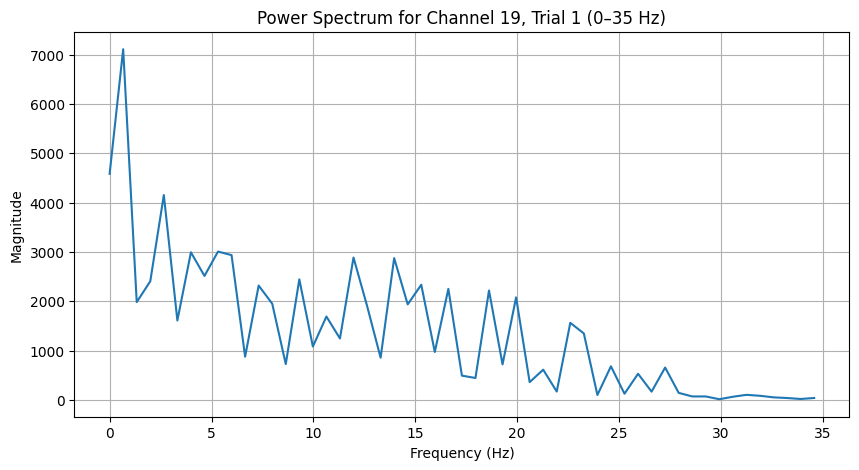

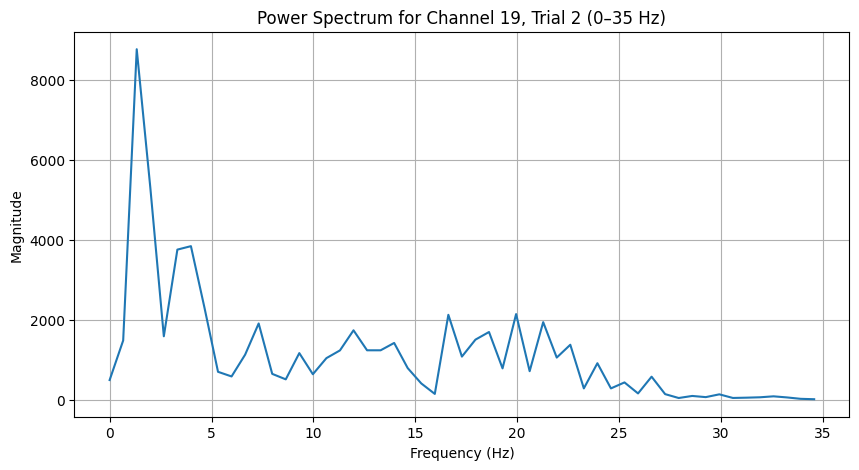

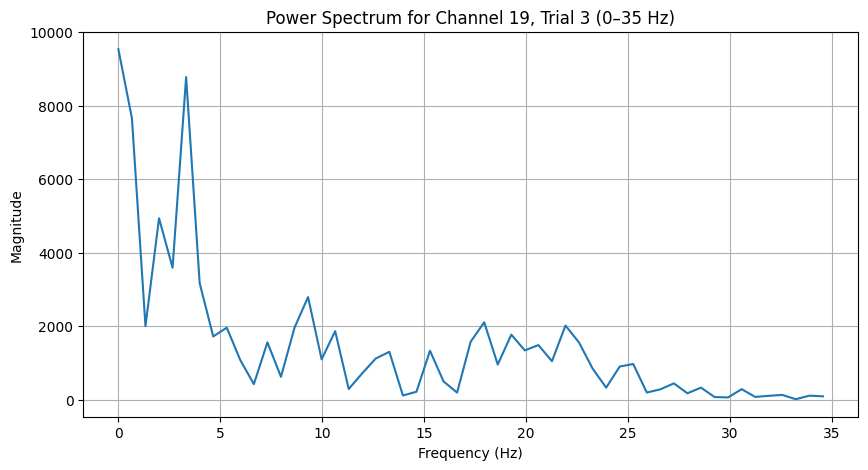

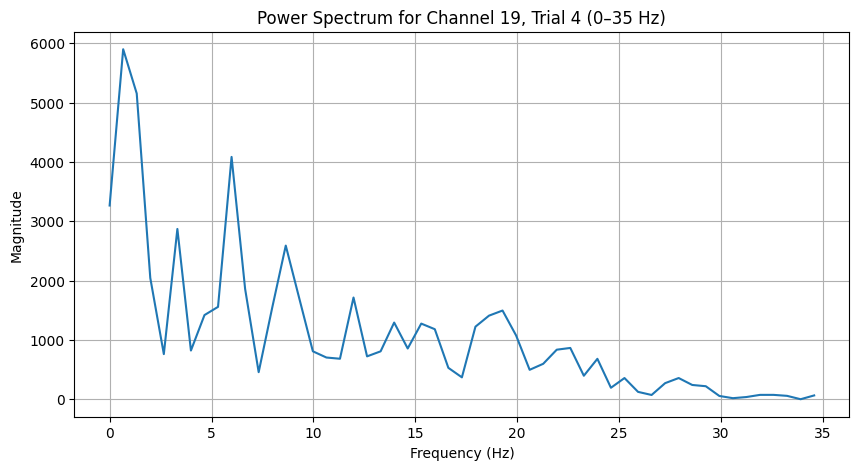

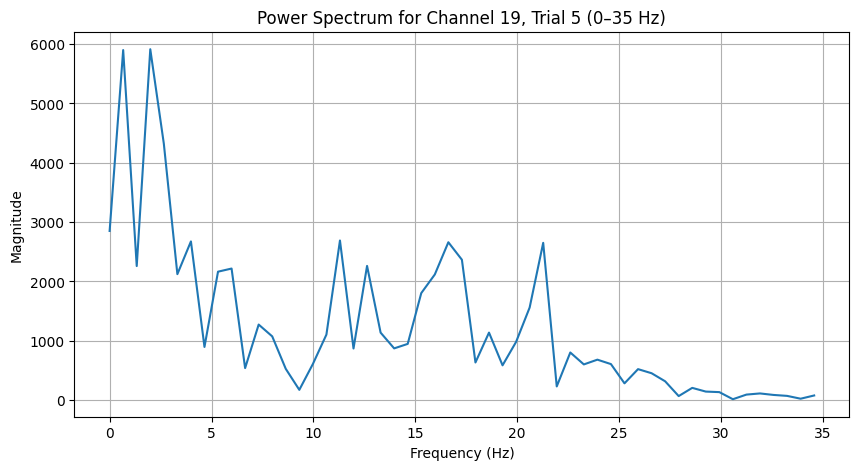

...

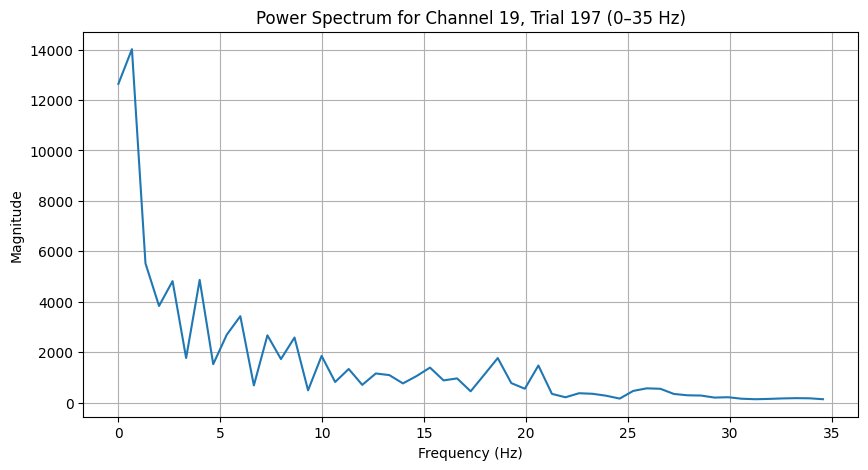

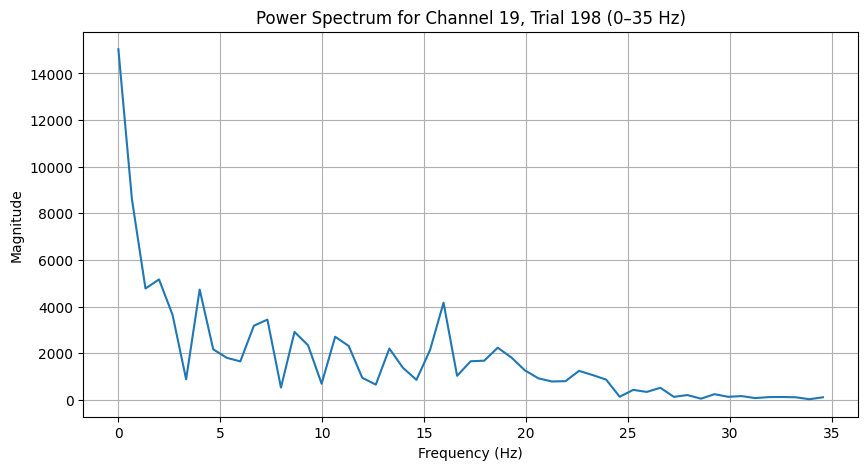

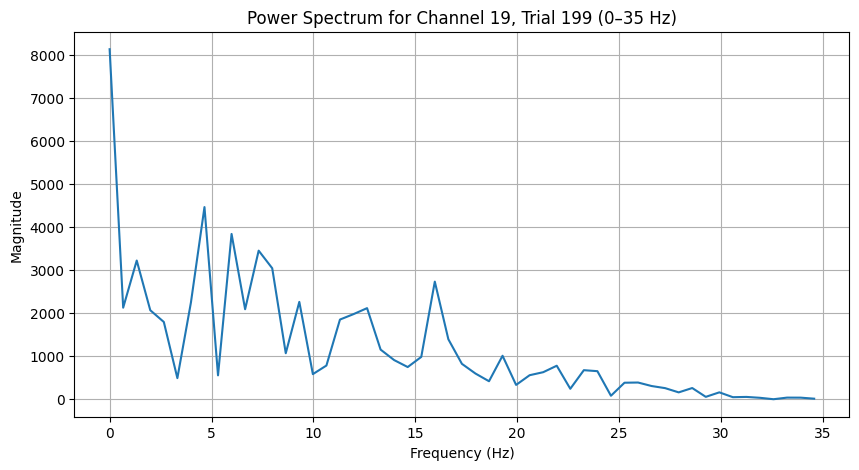

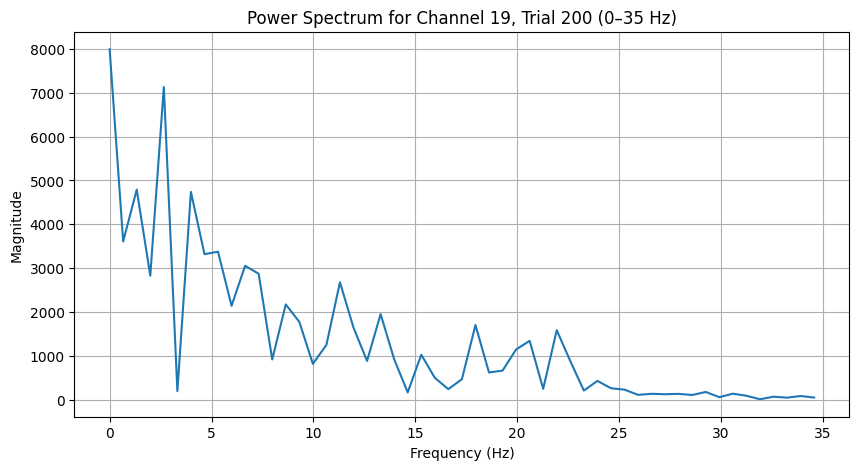

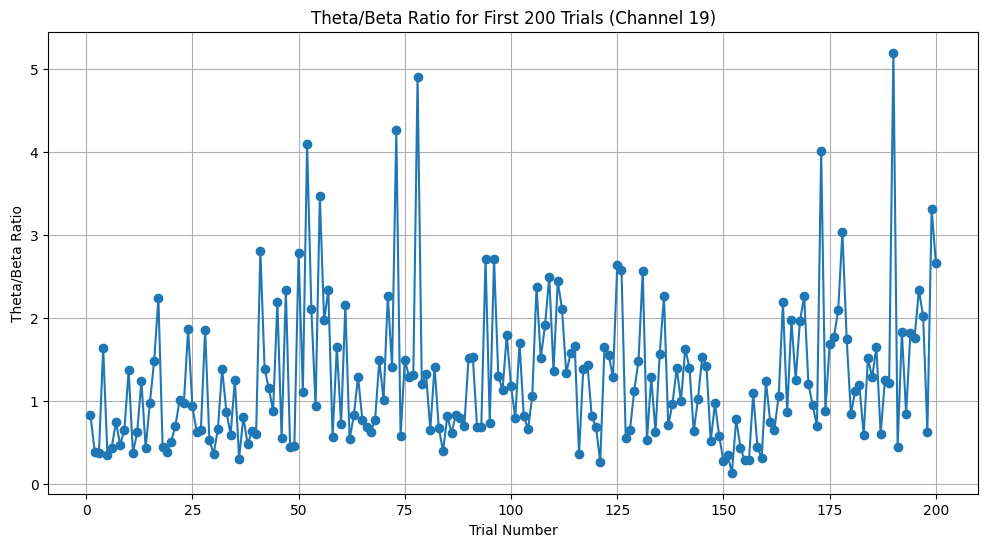

Average Theta/Beta Ratio: 1.28
Standard Deviation of Theta/Beta Ratio: 0.86


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import fft, fftfreq
import h5py  # Use h5py to load MATLAB v7.3 files

# Load the .mat file using h5py
file_path = '/content/drive/MyDrive/EEG_dataset/dataset/d6.mat'  # Update with your file path
with h5py.File(file_path, 'r') as mat_data:
    # Check the keys in the file to understand the structure
    print("Keys in the file:", list(mat_data.keys()))  # For debugging

    # Assuming EEG data is stored under a key 'd6' (replace if needed)
    eeg_data = mat_data['d6'][()]  # Load data into a NumPy array

# Set sampling parameters
fs = 256  # Sampling rate (Hz)
n = eeg_data.shape[0]  # Number of time points (385 in this case)
n_trials = 200  # Number of trials to analyze
channel_index = 18  # Channel 19 corresponds to index 18 in Python (0-based indexing)

# Define frequency bands
theta_band = (4, 8)   # Theta band range (4-8 Hz)
beta_band = (13, 30)  # Beta band range (13-30 Hz)

# Initialize list to store Theta/Beta ratios
theta_beta_ratios = []

# Loop through the first 200 trials and calculate the Theta/Beta ratio for each trial
for trial in range(n_trials):
    # Select the data for channel 19 (index 18) and the current trial
    trial_data = eeg_data[:, channel_index, trial]  # Channel 19, Trial index

    # Apply FFT to the selected trial data
    fft_values = fft(trial_data)
    frequencies = fftfreq(n, 1 / fs)  # Frequency bins

    # Take the absolute value of FFT to get the magnitude
    magnitude = np.abs(fft_values)

    # Filter to only include frequencies up to 35 Hz
    mask = (frequencies >= 0) & (frequencies <= 35)
    filtered_frequencies = frequencies[mask]
    filtered_magnitude = magnitude[mask]

    # Calculate power in Theta and Beta bands
    theta_mask = (filtered_frequencies >= theta_band[0]) & (filtered_frequencies <= theta_band[1])
    beta_mask = (filtered_frequencies >= beta_band[0]) & (filtered_frequencies <= beta_band[1])

    theta_power = np.sum(filtered_magnitude[theta_mask]**2)  # Sum of squared magnitudes for theta band
    beta_power = np.sum(filtered_magnitude[beta_mask]**2)    # Sum of squared magnitudes for beta band

    # Calculate Theta/Beta Ratio
    if beta_power > 0:  # Avoid division by zero
        theta_beta_ratio = theta_power / beta_power
    else:
        theta_beta_ratio = np.nan  # If beta power is zero, assign NaN

    # Append the ratio to the list
    theta_beta_ratios.append(theta_beta_ratio)

    # Plot the Power Spectrum for visual inspection (optional)
    plt.figure(figsize=(10, 5))
    plt.plot(filtered_frequencies, filtered_magnitude)
    plt.title(f'Power Spectrum for Channel 19, Trial {trial+1} (0–35 Hz)')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Magnitude')
    plt.grid(True)
    plt.show()  # Display the plot for the current trial

# Convert list to a NumPy array for further analysis
theta_beta_ratios = np.array(theta_beta_ratios)

# Plot Theta/Beta ratios for all 200 trials
plt.figure(figsize=(12, 6))
plt.plot(range(1, n_trials + 1), theta_beta_ratios, marker='o')
plt.title('Theta/Beta Ratio for First 200 Trials (Channel 19)')
plt.xlabel('Trial Number')
plt.ylabel('Theta/Beta Ratio')
plt.grid(True)
plt.show()

# Print summary statistics
print(f"Average Theta/Beta Ratio: {np.nanmean(theta_beta_ratios):.2f}")
print(f"Standard Deviation of Theta/Beta Ratio: {np.nanstd(theta_beta_ratios):.2f}")


In [ ]:
#theta/beta ratios for first 200 trials of d6 for Fp1
import numpy as np
from scipy.fft import fft, fftfreq
import h5py  # Use h5py to load MATLAB v7.3 files

# Load the .mat file using h5py
file_path = '/content/drive/MyDrive/EEG_dataset/dataset/d6.mat'  # Update with your file path
with h5py.File(file_path, 'r') as mat_data:
    # Assuming EEG data is stored under a key 'd6' (replace if needed)
    eeg_data = mat_data['d6'][()]  # Load data into a NumPy array

# Set sampling parameters
fs = 256  # Sampling rate (Hz)
n = eeg_data.shape[0]  # Number of time points (385 in this case)
n_trials = 200  # Number of trials to analyze
channel_index = 18  # Channel 19 corresponds to index 18 in Python (0-based indexing)

# Define frequency bands
theta_band = (4, 8)   # Theta band range (4-8 Hz)
beta_band = (13, 30)  # Beta band range (13-30 Hz)

# Initialize list to store Theta/Beta ratios
theta_beta_ratios = []

# Loop through the first 200 trials and calculate the Theta/Beta ratio for each trial
for trial in range(n_trials):
    # Select the data for channel 19 (index 18) and the current trial
    trial_data = eeg_data[:, channel_index, trial]  # Channel 19, Trial index

    # Apply FFT to the selected trial data
    fft_values = fft(trial_data)
    frequencies = fftfreq(n, 1 / fs)  # Frequency bins

    # Take the absolute value of FFT to get the magnitude
    magnitude = np.abs(fft_values)

    # Filter to only include frequencies up to 35 Hz
    mask = (frequencies >= 0) & (frequencies <= 35)
    filtered_frequencies = frequencies[mask]
    filtered_magnitude = magnitude[mask]

    # Calculate power in Theta and Beta bands
    theta_mask = (filtered_frequencies >= theta_band[0]) & (filtered_frequencies <= theta_band[1])
    beta_mask = (filtered_frequencies >= beta_band[0]) & (filtered_frequencies <= beta_band[1])

    theta_power = np.sum(filtered_magnitude[theta_mask]**2)  # Sum of squared magnitudes for theta band
    beta_power = np.sum(filtered_magnitude[beta_mask]**2)    # Sum of squared magnitudes for beta band

    # Calculate Theta/Beta Ratio
    if beta_power > 0:  # Avoid division by zero
        theta_beta_ratio = theta_power / beta_power
    else:
        theta_beta_ratio = np.nan  # If beta power is zero, assign NaN

    # Append the ratio to the list
    theta_beta_ratios.append(theta_beta_ratio)

    # Print the Theta/Beta ratio for the current trial
    print(f"Trial {trial + 1}: Theta/Beta Ratio = {theta_beta_ratio:.4f}")

# Convert list to a NumPy array for further analysis if needed
theta_beta_ratios = np.array(theta_beta_ratios)


Trial 1: Theta/Beta Ratio = 0.8382
Trial 2: Theta/Beta Ratio = 0.3920
Trial 3: Theta/Beta Ratio = 0.3725
Trial 4: Theta/Beta Ratio = 1.6406
Trial 5: Theta/Beta Ratio = 0.3503
Trial 6: Theta/Beta Ratio = 0.4360
Trial 7: Theta/Beta Ratio = 0.7484
Trial 8: Theta/Beta Ratio = 0.4757
Trial 9: Theta/Beta Ratio = 0.6565
Trial 10: Theta/Beta Ratio = 1.3700
Trial 11: Theta/Beta Ratio = 0.3750
Trial 12: Theta/Beta Ratio = 0.6217
Trial 13: Theta/Beta Ratio = 1.2425
Trial 14: Theta/Beta Ratio = 0.4335
Trial 15: Theta/Beta Ratio = 0.9791
Trial 16: Theta/Beta Ratio = 1.4864
Trial 17: Theta/Beta Ratio = 2.2380
Trial 18: Theta/Beta Ratio = 0.4423
Trial 19: Theta/Beta Ratio = 0.3808
Trial 20: Theta/Beta Ratio = 0.5129
Trial 21: Theta/Beta Ratio = 0.7000
Trial 22: Theta/Beta Ratio = 1.0144
Trial 23: Theta/Beta Ratio = 0.9827
Trial 24: Theta/Beta Ratio = 1.8694
Trial 25: Theta/Beta Ratio = 0.9364
Trial 26: Theta/Beta Ratio = 0.6298
Trial 27: Theta/Beta Ratio = 0.6548
Trial 28: Theta/Beta Ratio = 1.8623
T

Keys in the file: ['d6']


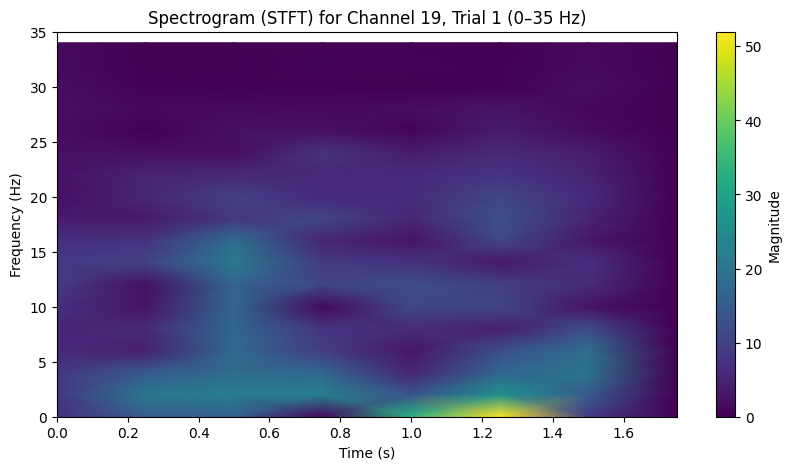

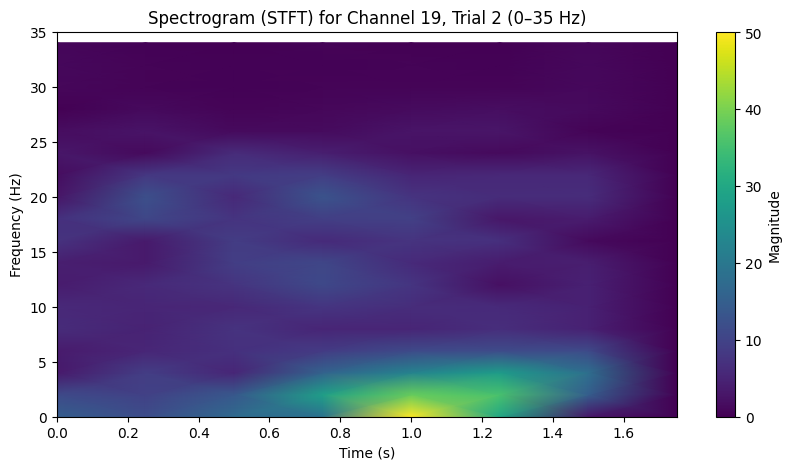

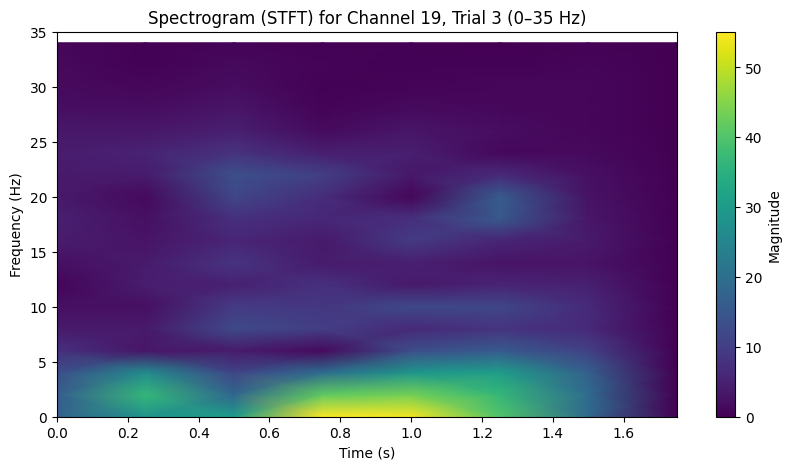

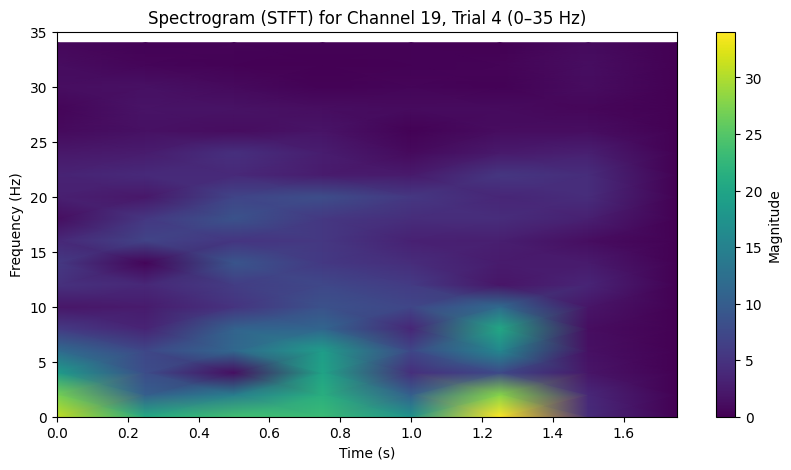

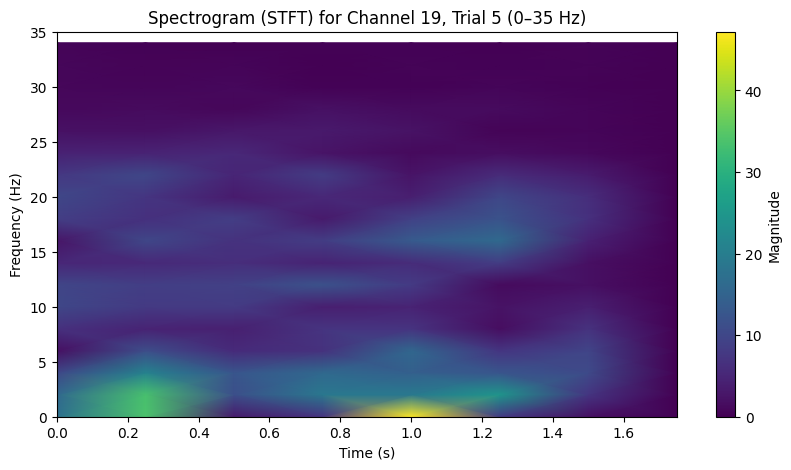

...

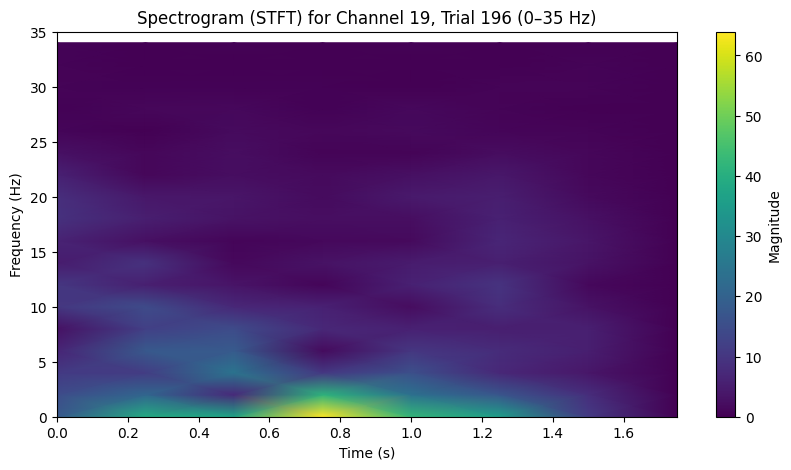

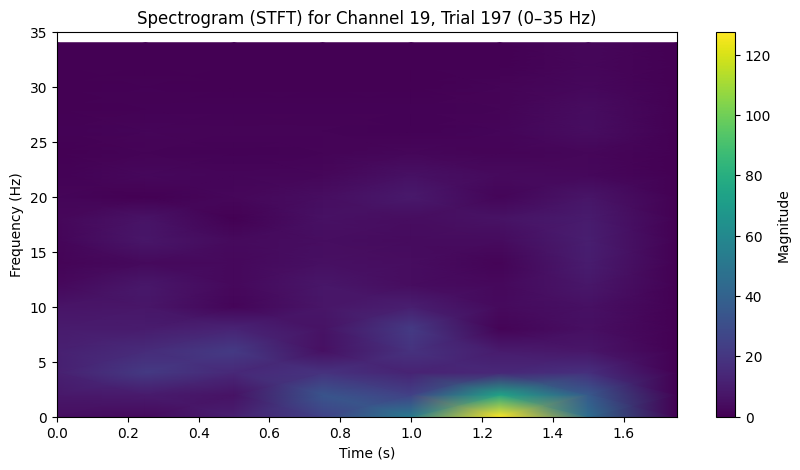

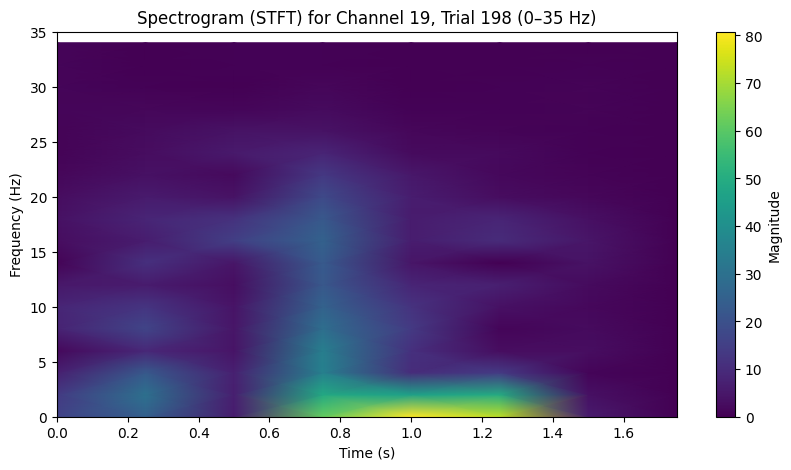

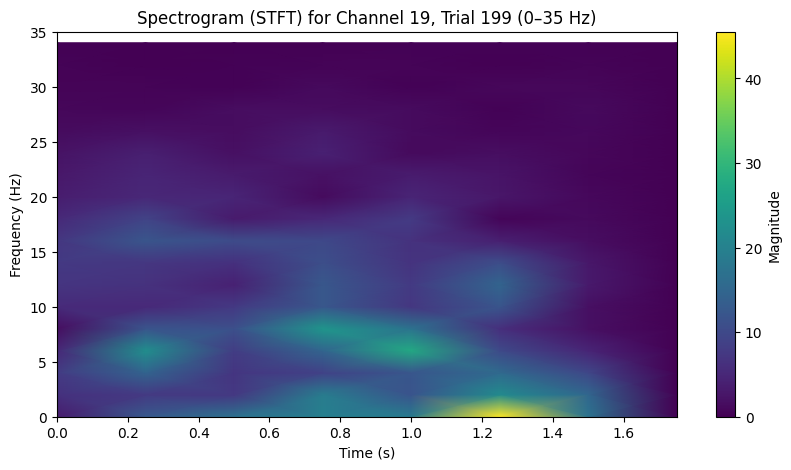

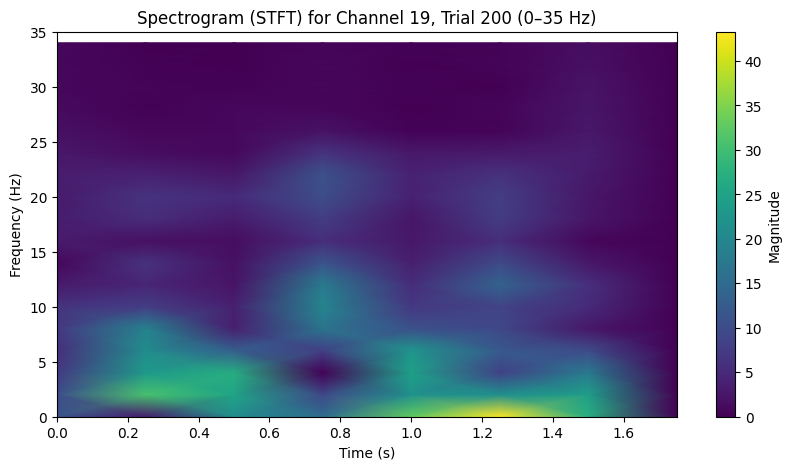

In [ ]:
#sftf for first 200 trials of d6 for Fp1
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import stft
import h5py  # Use h5py to load MATLAB v7.3 files

# Load the .mat file using h5py
file_path = '/content/drive/MyDrive/EEG_dataset/dataset/d6.mat'  # Update with your file path
with h5py.File(file_path, 'r') as mat_data:
    # Check the keys in the file to understand the structure
    print("Keys in the file:", list(mat_data.keys()))  # For debugging

    # Assuming EEG data is stored under a key 'd6' (replace if needed)
    eeg_data = mat_data['d6'][()]  # Load data into a NumPy array

# Set sampling parameters
fs = 256  # Sampling rate (Hz)
n = eeg_data.shape[0]  # Number of time points (385 in this case)
n_trials = 200  # Number of trials to analyze
channel_index = 18  # Channel 19 corresponds to index 18 in Python (0-based indexing)

# Parameters for STFT
window = 'hann'  # Hanning window
nperseg = 128  # Length of each segment (in samples)
noverlap = nperseg // 2  # Overlap between segments (50%)

# Loop through the first 200 trials and calculate STFT for each trial
for trial in range(n_trials):
    # Select the data for channel 19 (index 18) and the current trial
    trial_data = eeg_data[:, channel_index, trial]  # Channel 19, Trial index

    # Compute the STFT for the selected trial data
    frequencies, times, Zxx = stft(trial_data, fs=fs, window=window, nperseg=nperseg, noverlap=noverlap)

    # Filter to only include frequencies up to 35 Hz
    freq_mask = (frequencies <= 35)
    filtered_frequencies = frequencies[freq_mask]
    Zxx_filtered = Zxx[freq_mask, :]

    # Create a separate plot for each trial's spectrogram (STFT)
    plt.figure(figsize=(10, 5))
    plt.pcolormesh(times, filtered_frequencies, np.abs(Zxx_filtered), shading='gouraud')
    plt.title(f'Spectrogram (STFT) for Channel 19, Trial {trial+1} (0–35 Hz)')
    plt.ylabel('Frequency (Hz)')
    plt.xlabel('Time (s)')
    plt.colorbar(label='Magnitude')
    plt.ylim([0, 35])  # Limit the frequency range to 0-35 Hz
    plt.show()  # Display the plot for the current trial


In [ ]:
#trials  which exceed threshold value 3.00 for theta/beta ratios of first 200 trials in d6 Fp1
import numpy as np
import h5py
from scipy.fft import fft, fftfreq

# Load the .mat file using h5py
file_path = '/content/drive/MyDrive/EEG_dataset/dataset/d6.mat'  # Update with your file path
with h5py.File(file_path, 'r') as mat_data:
    # Check the keys in the file to understand the structure
    print("Keys in the file:", list(mat_data.keys()))  # For debugging

    # Assuming EEG data is stored under a key 'd6' (replace if needed)
    eeg_data = mat_data['d6'][()]  # Load data into a NumPy array

# Set sampling parameters
fs = 256  # Sampling rate (Hz)
n = eeg_data.shape[0]  # Number of time points (385 in this case)
n_trials = 200  # Number of trials to analyze
channel_index = 18  # Channel 19 corresponds to index 18 in Python (0-based indexing)

# Define frequency bands for Theta (4-8 Hz) and Beta (13-30 Hz)
theta_band = (4, 8)
beta_band = (13, 30)
threshold = 3.0  # Threshold value for attention analysis

# List to store trial indices that exceed the threshold
low_attention_trials = []

# Loop through the first 200 trials and calculate the Theta/Beta ratio for each trial
for trial in range(n_trials):
    # Select the data for channel 19 (index 18) and the current trial
    trial_data = eeg_data[:, channel_index, trial]  # Channel 19, Trial index

    # Apply FFT to the selected trial data
    fft_values = fft(trial_data)
    frequencies = fftfreq(n, 1 / fs)  # Frequency bins

    # Take the absolute value of FFT to get the magnitude
    magnitude = np.abs(fft_values)

    # Calculate the power in the Theta band (4-8 Hz)
    theta_mask = (frequencies >= theta_band[0]) & (frequencies <= theta_band[1])
    theta_power = np.sum(magnitude[theta_mask] ** 2)

    # Calculate the power in the Beta band (13-30 Hz)
    beta_mask = (frequencies >= beta_band[0]) & (frequencies <= beta_band[1])
    beta_power = np.sum(magnitude[beta_mask] ** 2)

    # Calculate the Theta/Beta ratio
    if beta_power != 0:  # Avoid division by zero
        theta_beta_ratio = theta_power / beta_power
    else:
        theta_beta_ratio = np.inf  # Assign infinite ratio if beta power is zero

    # Check if the ratio exceeds the threshold and add to the list if true
    if theta_beta_ratio > threshold:
        low_attention_trials.append((trial + 1, theta_beta_ratio))

# Print the trials that exceed the threshold value
if low_attention_trials:
    print(f"Trials with Theta/Beta Ratio > {threshold}:")
    for trial_num, ratio in low_attention_trials:
        print(f"Trial {trial_num}: Theta/Beta Ratio = {ratio:.2f}")
else:
    print(f"No trials exceed the Theta/Beta Ratio threshold of {threshold}.")


Keys in the file: ['d6']
Trials with Theta/Beta Ratio > 3.0:
Trial 52: Theta/Beta Ratio = 4.10
Trial 55: Theta/Beta Ratio = 3.47
Trial 73: Theta/Beta Ratio = 4.26
Trial 78: Theta/Beta Ratio = 4.91
Trial 173: Theta/Beta Ratio = 4.01
Trial 178: Theta/Beta Ratio = 3.04
Trial 190: Theta/Beta Ratio = 5.20
Trial 199: Theta/Beta Ratio = 3.31


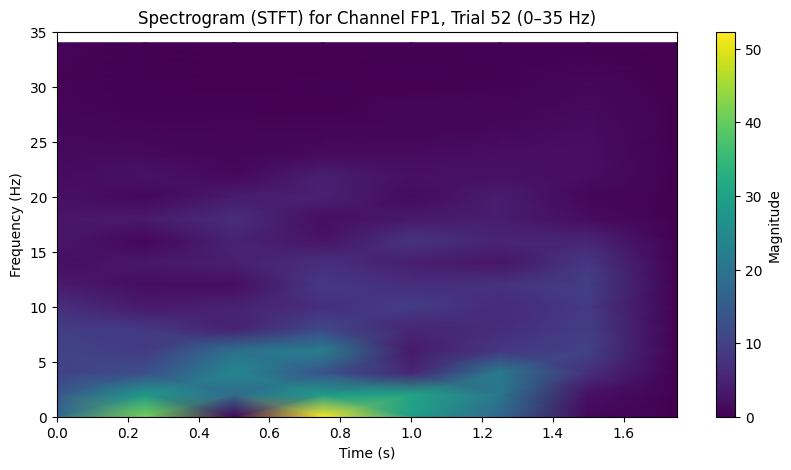

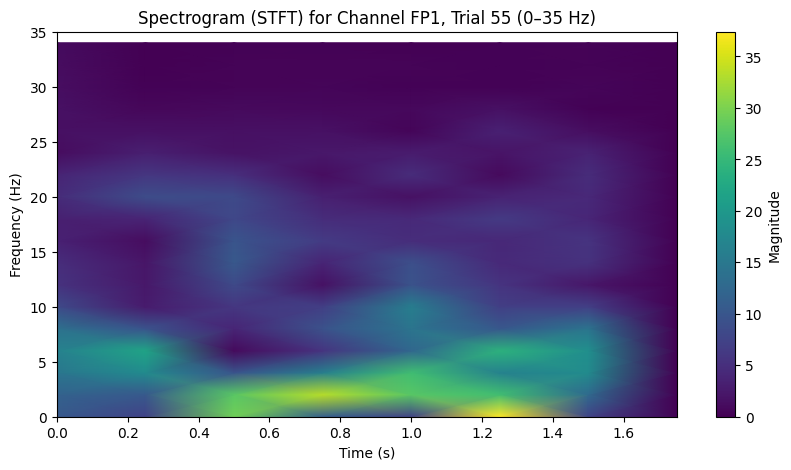

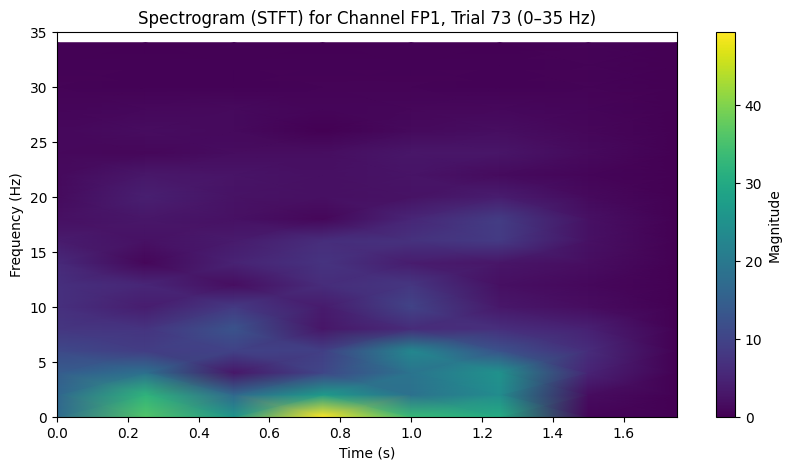

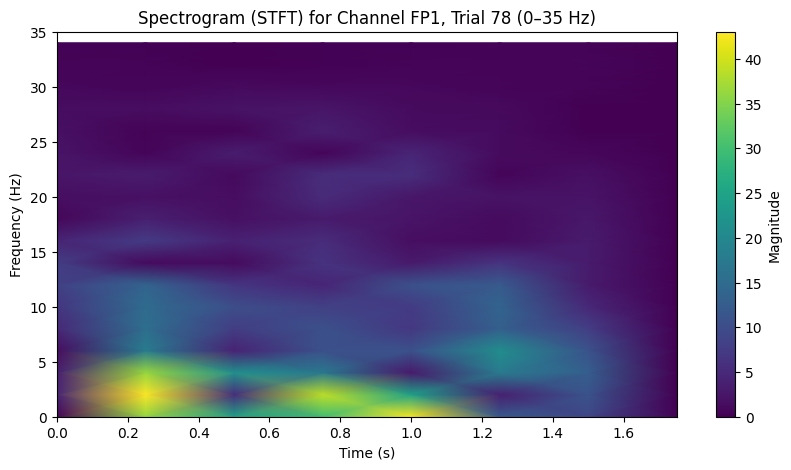

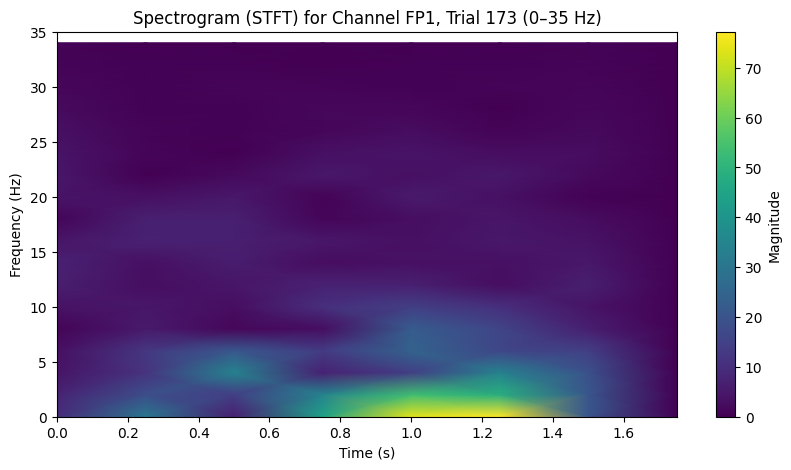

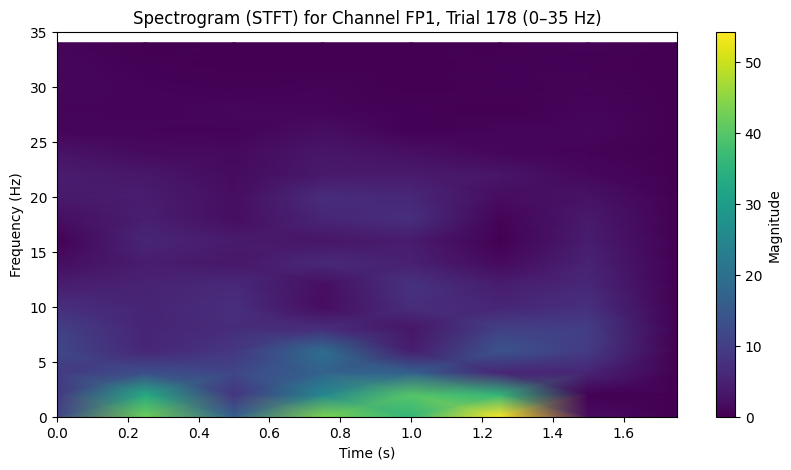

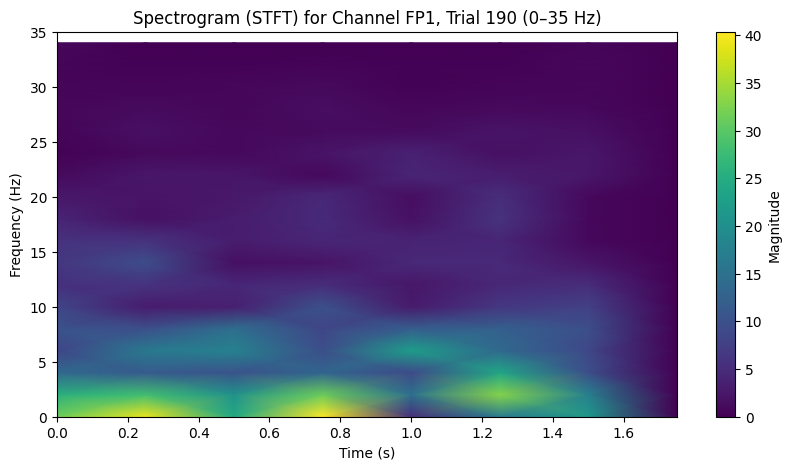

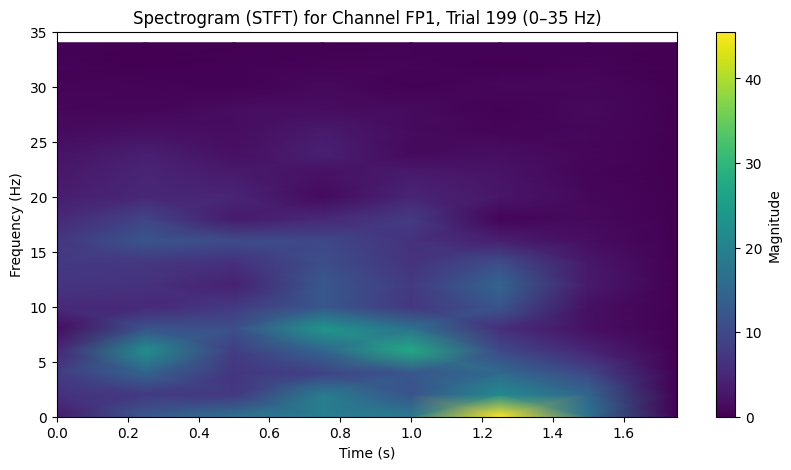

In [ ]:
#did sftf for trials which exceed threshold value 3.00 for theta/beta ratios of first 200 trials in d6 Fp1
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import stft
import h5py

# Load the .mat file using h5py
file_path = '/content/drive/MyDrive/EEG_dataset/dataset/d6.mat'  # Update with your file path
with h5py.File(file_path, 'r') as mat_data:
    # Assuming EEG data is stored under a key 'd6'
    eeg_data = mat_data['d6'][()]  # Load data into a NumPy array

# Set sampling parameters
fs = 256  # Sampling rate (Hz)
n = eeg_data.shape[0]  # Number of time points (385 in this case)
channel_index = 18  # Channel 19 corresponds to index 18 (FP1)
trials_to_analyze = [52, 55, 73, 78, 173, 178, 190, 199]  # Trials exceeding the threshold

# Parameters for STFT
window = 'hann'  # Hanning window
nperseg = 128  # Length of each segment (in samples)
noverlap = nperseg // 2  # Overlap between segments (50%)

# Loop through each trial in the list and generate STFT plots
for trial in trials_to_analyze:
    # Select the data for channel 19 (FP1) and the specific trial
    trial_data = eeg_data[:, channel_index, trial - 1]  # Channel 19, Trial index (adjusted for 0-based indexing)

    # Compute STFT for the selected trial
    frequencies, times, Zxx = stft(trial_data, fs=fs, window=window, nperseg=nperseg, noverlap=noverlap)

    # Filter to only include frequencies up to 35 Hz
    freq_mask = (frequencies <= 35)
    filtered_frequencies = frequencies[freq_mask]
    Zxx_filtered = Zxx[freq_mask, :]

    # Plot the STFT spectrogram
    plt.figure(figsize=(10, 5))
    plt.pcolormesh(times, filtered_frequencies, np.abs(Zxx_filtered), shading='gouraud')
    plt.title(f'Spectrogram (STFT) for Channel FP1, Trial {trial} (0–35 Hz)')
    plt.ylabel('Frequency (Hz)')
    plt.xlabel('Time (s)')
    plt.colorbar(label='Magnitude')
    plt.ylim([0, 35])  # Limit the frequency range to 0-35 Hz
    plt.show()


In [ ]:
import scipy.io as sio

# File path
combined_eeg_file_path = '/content/drive/MyDrive/EEG_dataset/ADHD_Files_combined.mat'

# Load the .mat file
mat_data = sio.loadmat(combined_eeg_file_path)

# Access the key storing the combined data
combined_data = mat_data['combined_data']  # Replace 'combined_data' with the actual key if different

# Get the shape of the data
print("Shape of combined_data:", combined_data.shape)